# Climate-Friendly Food Systems (CFFS) Labelling Project

### The University of British Columbia

***

## Part IV: Data Analysis

## Set up and Import Libraries

In [1]:
#pip install -r requirements.txt

In [1]:
import numpy as np
import pandas as pd
import pdpipe as pdp
import matplotlib.pyplot as plt
import glob
import os
import csv
from itertools import islice
from decimal import Decimal
import xml.etree.ElementTree as et
from xml.etree.ElementTree import parse
import openpyxl
import pytest
pd.set_option('mode.chained_assignment', None)

In [3]:
# Set the root path, change the the current working directory into the project folder
path = "C:/Users/ENTER_HERE/CFFS-S23/CFFS-22-23"
# path = os.getcwd()
os.chdir(path)

In [4]:
# Enable reading data table in the scrolling window if you prefer
pd.set_option("display.max_rows", None, "display.max_columns", None)

***
## Import Cleaned Datasets

In [5]:
Items = pd.read_csv(os.path.join(os.getcwd(), "data", "preprocessed", "Items_List.csv"))
Items.dtypes

ItemId             object
Description        object
CaseQty           float64
CaseUOM            object
PakQty            float64
PakUOM             object
InventoryGroup     object
dtype: object

In [6]:
Items.head()

,ItemId,Description,CaseQty,CaseUOM,PakQty,PakUOM,InventoryGroup
0,I-7631,5 SPICE POWDER,1.0,ea,1.0,lb,SPICES
1,I-2353,"9""X6"" 2-COMPARTMENT CLAMSHELL",200.0,CT,1.0,CT,DISPOSABLES
2,I-43239,AGAR AGAR POWDER,500.0,g,1.0,g,SPICES
3,I-57481,AHA WATER SP BLUEB POM PET,24.0,each,1.0,each,BEVERAGE
4,I-57484,AHA WATER SP PEACH HONEY PET,24.0,each,1.0,each,BEVERAGE


In [7]:
Ingredients = pd.read_csv(os.path.join(os.getcwd(), "data", "preprocessed", "Ingredients_List.csv"))
Ingredients.dtypes

IngredientId     object
Qty             float64
Uom              object
Conversion      float64
InvFactor       float64
Recipe           object
dtype: object

In [8]:
Ingredients

,IngredientId,Qty,Uom,Conversion,InvFactor,Recipe
0,P-48933,1.000,Kg,1.000000e+00,1.0000,P-10113
1,P-18746,1.000,Kg,1.000000e+00,1.0000,P-10241
2,I-3388,1.000,L,1.000000e+00,0.3058,P-10496
3,I-4658,2.270,Kg,2.204620e+00,0.6942,P-10496
4,I-1813,30.000,ml,3.381406e-02,9.3750,P-10502
5,I-6026,15.000,g,1.000000e+00,4.6875,P-10502
6,I-60772,3.000,L,1.000000e+00,0.9375,P-10502
7,P-26020,100.000,g,1.000000e-03,31.2500,P-10502
8,P-41466,200.000,g,1.000000e+00,62.5000,P-10502
9,P-45879,7.500,Kg,1.000000e+00,1.8750,P-10873


In [9]:
Ingredients.head()

,IngredientId,Qty,Uom,Conversion,InvFactor,Recipe
0,P-48933,1.00,Kg,1.000000,1.0000,P-10113
1,P-18746,1.00,Kg,1.000000,1.0000,P-10241
2,I-3388,1.00,L,1.000000,0.3058,P-10496
3,I-4658,2.27,Kg,2.204620,0.6942,P-10496
4,I-1813,30.00,ml,0.033814,9.3750,P-10502


In [10]:
Preps = pd.read_csv(os.path.join(os.getcwd(), "data", "cleaning", "Preps_List_Cleaned.csv"))
Preps.dtypes

PrepId             object
Description        object
PakQty            float64
PakUOM             object
InventoryGroup     object
StdQty            float64
StdUom             object
dtype: object

In [11]:
Preps.head()
Preps.shape

(1742, 7)

In [12]:
Products = pd.read_csv(os.path.join(os.getcwd(), "data", "preprocessed", "Products_List.csv"))
Products.dtypes

ProdId         object
Description    object
SalesGroup     object
dtype: object

In [13]:
Products.head()

,ProdId,Description,SalesGroup
0,R-67294,$1 OWN MUG ETHICAL BEAN COFFEE,BEVERAGE
1,R-62976,ADD CUP,OK - GRAB & GO
2,R-31006,ADD|Beef,OK - CUSTOM KITCHEN
3,R-31131,ADD|Chicken,OK - CUSTOM KITCHEN
4,R-30154,ADD|Crackers,OK - CUSTOM KITCHEN


In [14]:
Conversions = pd.read_csv(os.path.join(os.getcwd(), "data", "cleaning", "Conversions_Added.csv"))
Conversions.dtypes

ConversionId       object
Multiplier        float64
ConvertFromQty    float64
ConvertFromUom     object
ConvertToQty      float64
ConvertToUom       object
dtype: object

In [15]:
Conversions

,ConversionId,Multiplier,ConvertFromQty,ConvertFromUom,ConvertToQty,ConvertToUom
0,NaN,1.000000,1.0000,XXX,1.0000,L
1,NaN,0.877193,1.0000,1.14L,1.1400,L
2,NaN,0.666667,1.0000,1.5L,1.5000,L
3,NaN,0.571429,1.0000,1.75 L,1.7500,L
4,NaN,0.500000,1.0000,2L,2.0000,L
5,NaN,0.250000,1.0000,4L,4.0000,L
6,NaN,0.083333,1.0000,FOOT,12.0000,INCH
7,NaN,0.062500,1.0000,16L,16.0000,L
8,NaN,0.059172,1.0000,1/2LTR,16.9000,fl oz
9,NaN,0.039370,1.0000,750ML,25.4000,fl oz


In [16]:
mapping = pd.read_csv(os.path.join(os.getcwd(), "data", "mapping", "Mapping.csv"))
mapping.dtypes

ItemId                                                     object
CategoryID                                                float64
Description                                                object
CaseQty                                                   float64
CaseUOM                                                    object
PakQty                                                    float64
PakUOM                                                     object
InventoryGroup                                             object
Active Total Supply Chain Emissions (kg CO2 / kg food)    float64
g N lost/kg product                                       float64
Land Use (m^2)                                            float64
Freshwater Withdrawals (L/FU)                             float64
Stress-Weighted Water Use (L/FU)                          float64
dtype: object

In [17]:
mapping

,ItemId,CategoryID,Description,CaseQty,CaseUOM,PakQty,PakUOM,InventoryGroup,Active Total Supply Chain Emissions (kg CO2 / kg food),g N lost/kg product,Land Use (m^2),Freshwater Withdrawals (L/FU),Stress-Weighted Water Use (L/FU)
0,I-57545,1.0,CHUCK FLAT BONELESS FZN,3.300,Kg,1.000,Kg,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
1,I-10869,1.0,BEEF STIRFRY COV FR,5.000,Kg,1.000,Kg,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
2,I-7064,1.0,BEEF OUTSIDE FLAT AAA,1.000,Kg,1.000,Kg,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
3,I-37005,1.0,BEEF MEATBALLS,4.540,Kg,1000.000,g,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
4,I-37002,1.0,BEEF INSIDE ROUND SHAVED,9.000,Kg,1000.000,g,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
5,I-3876,1.0,BEEF CHUCK GROUND AAA,1.000,Kg,1.000,Kg,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
6,I-34065,1.0,BEEF BONES KNUCKLE FZ,1.000,Kg,1.000,Kg,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
7,I-11661,1.0,"BEEF STEW 3/4"" FROZEN",5.000,Kg,1.000,Kg,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
8,I-3837,1.0,"BEEF STEW DICED 3/4""FR",1.000,Kg,1.000,Kg,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000
9,I-43648,1.0,BRISKET BEEF CORN SMKD FR,4.500,Kg,1.000,Kg,MEAT,41.346300,329.500000,0.12645,1677.200000,61309.0000


In [18]:
# Check if there are any duplicates in the mapping dataframe, "ItemId" column? False is good.
check = mapping["ItemId"].duplicated().any()
check

False

In [19]:
mapping.loc[mapping["ItemId"] == 'I-62863']

,ItemId,CategoryID,Description,CaseQty,CaseUOM,PakQty,PakUOM,InventoryGroup,Active Total Supply Chain Emissions (kg CO2 / kg food),g N lost/kg product,Land Use (m^2),Freshwater Withdrawals (L/FU),Stress-Weighted Water Use (L/FU)
1988,I-62863,59.0,CK|G&G|HMR|Meat Ball & Pasta.,1.0,ea,1.0,ea,PRODUCTION FOOD,0.0,0.0,0.0,0.0,0.0


### Unit Converter

In [20]:
# Import standard unit conversion information for items
Std_Unit = pd.read_csv(os.path.join(os.getcwd(), "data", "external", "standard_conversions.csv"))
Std_Unit.head()

,Multiplier,ConvertFromQty,ConvertFromUom,ConvertToQty,ConvertToUom
0,4.92890,1,tsp,4.92890,ml
1,14.78700,1,Tbsp,14.78700,ml
2,946.35000,1,qt,946.35000,ml
3,473.17625,1,pt,473.17625,ml
4,28.34950,1,oz,28.34950,g


In [21]:
# Import list of prep that need convert uom to standard uom manually
Manual_PrepU = pd.read_csv(os.path.join(os.getcwd(), "data", "cleaning", "update", "Preps_UpdateUom.csv"))
Manual_PrepU.head()

,PrepId,Description,PakQty,PakUOM,InventoryGroup,StdQty,StdUom
0,P-54697,LEMON|Wedge 1/8,8.0,each,PREP,84.0,g
1,P-35132,MARINATED|Lemon & Herb Chx,185.0,ea,PREP,24050.0,g
2,P-51992,YIELD|Bread|Sourdough 5/8,36.0,slice,NaN,1620.0,g
3,P-26234,BATCH|Roasted Garlic Bread,16.0,ea,PREP,1280.0,g
4,P-26170,GRILLED|NaanBread,1.0,ea,PREP,125.0,g


In [22]:
# Add unit conversion info for preps into converter
Prep_cov = Manual_PrepU[['PrepId', 'PakQty','PakUOM','StdQty','StdUom']]
Prep_cov.insert(1, "Multiplier", '')
Prep_cov.columns = Conversions.columns

# Prep_cov.loc['Multiplier'] = Prep_cov['ConvertFromQty']/Prep_cov['ConvertToQty']
for index, row in Prep_cov.iterrows():
    # print(Prep_cov.loc[index, 'ConvertFromQty'])
    Prep_cov.loc[index, 'Multiplier'] = Prep_cov.loc[index, 'ConvertFromQty']/Prep_cov.loc[index, 'ConvertToQty']
Prep_cov.head()
Prep_cov.tail()

,ConversionId,Multiplier,ConvertFromQty,ConvertFromUom,ConvertToQty,ConvertToUom
446,P-71329,0.006579,44.0,each,6688.0,g
447,P-62067,0.04,12.0,slice,300.0,g
448,P-70682,0.006993,60.0,each,8580.0,g
449,P-64994,0.03125,15.0,slice,480.0,g
450,P-71666,0.027027,20.0,slice,740.0,g


In [23]:
# Drop duplicates and concatenate DataFrames: Conversions and Prep_cov to make a DataFrame: frames
frames = [Conversions, Prep_cov]
Conversions = pd.concat(frames).reset_index(drop=True, inplace=False).drop_duplicates()
Conversions.tail()

,ConversionId,Multiplier,ConvertFromQty,ConvertFromUom,ConvertToQty,ConvertToUom
1088,P-71329,0.006579,44.0,each,6688.0,g
1089,P-62067,0.04,12.0,slice,300.0,g
1090,P-70682,0.006993,60.0,each,8580.0,g
1091,P-64994,0.03125,15.0,slice,480.0,g
1092,P-71666,0.027027,20.0,slice,740.0,g


In [24]:
# Seperate uoms that converted to 'ml' or 'g'
liquid_unit = Std_Unit.loc[Std_Unit['ConvertToUom'] == 'ml', 'ConvertFromUom'].tolist()
solid_unit = Std_Unit.loc[Std_Unit['ConvertToUom'] == 'g', 'ConvertFromUom'].tolist()

In [25]:
# Construct a standard unit converter
def std_converter(qty, uom):
    if uom in Std_Unit['ConvertFromUom'].tolist():
        multiplier = Std_Unit.loc[Std_Unit['ConvertFromUom'] == uom, 'Multiplier']
        Qty = float(qty)*float(multiplier)
        Uom = Std_Unit.loc[Std_Unit['ConvertFromUom'] == uom, 'ConvertToUom'].values[0]
    else:
        Qty = qty
        Uom = uom
    return (Qty, Uom)

In [26]:
# Test the std_converter
std_converter(0.25,'lb')

(113.398, 'g')

In [27]:
# Construct a unit converter for specific items
spc_cov = list(filter(None, Conversions['ConversionId'].tolist()))

def spc_converter(ingre, qty, uom):
    if uom in liquid_unit + solid_unit: #convert to std uom for ingredients has no specific convention instruction
        return std_converter(qty, uom)
    elif ingre in spc_cov: #convert to std uom for ingredients has specific convention instruction
        conversion = Conversions.loc[(Conversions['ConversionId'] == ingre) & (Conversions['ConvertFromUom'] == uom)
                                    & (Conversions['ConvertToUom'] == 'g')]
        conversion.drop_duplicates(subset=['ConversionId'], inplace = True)
        multiplier = conversion['Multiplier']
        if multiplier.empty:
            return std_converter(qty, uom)
        else: 
            #print(conversion)
            Qty = float(qty)/float(multiplier)
            Uom = conversion['ConvertToUom'].values[0]
            return (Qty, Uom)
    else:
        return std_converter(qty, uom)

In [28]:
spc_cov

[nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 'Iqq-1093',
 'I-1100',
 'I-1120',
 'I-1195',
 'I-1197',
 'I-1232',
 'I-1277',
 'I-1791',
 'I-1791',
 'I-1813',
 'I-1813',
 'I-1814',
 'I-1814',
 'I-1815',
 'I-1815',
 'I-1820',
 'I-1820',
 'I-1821',
 'I-1821',
 'I-1827',
 'I-1827',
 'I-2074',
 'I-2074',
 'I-2159',
 'I-2159',
 'I-2159',
 'I-2205',
 'I-2205',
 'I-2205',
 'I-2207',
 'I-2207',
 'I-2207',
 'I-2217',
 'I-2218',
 'I-2218',
 'I-2218',
 'I-2220',
 'I-2220',
 'I-2220',
 'I-2221',
 'I-2221',
 'I-2221',
 'I-2236',
 'I-2236',
 'I-2236',
 'I-2244',
 'I-2248',
 'I-2248',
 'I-2251',
 'I-2251',
 'I-2251',
 'I-2252',
 'I-2252',
 'I-2252',
 'I-2252',
 'I-2254',
 'I-2254',
 'I-2306',
 'I-2310',
 'I-2933',
 'I-3074',
 'I-3113',
 'I-3113',
 'I-3113',
 'I-3141',
 'I-3143',
 'I-3143',
 'I-3144',
 'I-3144',
 'I-3144',
 'I-31

In [29]:
# Test the spc_converter
spc_converter('I-1120', 1, 'CT')

(50.0, 'g')

In [30]:
spc_converter('P-35132', 1, 'ea')

(130.0, 'g')

## GHG Factors Calculation for Preps

In [31]:
# Created new columns with emissions factors
Preps['GHG Emission (g)'] = 0
Preps['GHG Emission(g)/StdUom'] = 0
Preps['N lost (g)'] = 0
Preps['N lost (g)/StdUom'] = 0
Preps['Freshwater Withdrawals (ml)'] = 0
Preps['Freshwater Withdrawals (ml)/StdUom'] = 0
Preps['Stress-Weighted Water Use (ml)'] = 0
Preps['Stress-Weighted Water Use (ml)/StdUom'] = 0
Preps['Land Use (m^2)'] = 0
Preps['Land Use (m^2)/StdUom'] = 0

In [32]:
Ingredients.head()

,IngredientId,Qty,Uom,Conversion,InvFactor,Recipe
0,P-48933,1.00,Kg,1.000000,1.0000,P-10113
1,P-18746,1.00,Kg,1.000000,1.0000,P-10241
2,I-3388,1.00,L,1.000000,0.3058,P-10496
3,I-4658,2.27,Kg,2.204620,0.6942,P-10496
4,I-1813,30.00,ml,0.033814,9.3750,P-10502


In [33]:
Preps.loc[Preps["PrepId"] == "P-67984"]

,PrepId,Description,PakQty,PakUOM,InventoryGroup,StdQty,StdUom,GHG Emission (g),GHG Emission(g)/StdUom,N lost (g),N lost (g)/StdUom,Freshwater Withdrawals (ml),Freshwater Withdrawals (ml)/StdUom,Stress-Weighted Water Use (ml),Stress-Weighted Water Use (ml)/StdUom,Land Use (m^2),Land Use (m^2)/StdUom
78,P-67984,BATCH|Vegetable Biryani,22.0,Kg,PREP,22000.0,g,0,0,0,0,0,0,0,0,0,0


In [34]:
Preps.head()

,PrepId,Description,PakQty,PakUOM,InventoryGroup,StdQty,StdUom,GHG Emission (g),GHG Emission(g)/StdUom,N lost (g),N lost (g)/StdUom,Freshwater Withdrawals (ml),Freshwater Withdrawals (ml)/StdUom,Stress-Weighted Water Use (ml),Stress-Weighted Water Use (ml)/StdUom,Land Use (m^2),Land Use (m^2)/StdUom
0,P-61322,AIOLI|Pesto,4.0,L,ZDONT USE OK - PREP,4000.00,ml,0,0,0,0,0,0,0,0,0,0
1,P-61009,ALF|Flatbread|Brisket,1.0,un,NaN,309.01,g,0,0,0,0,0,0,0,0,0,0
2,P-26184,BAKED|Beans,9.0,Kg,PREP,9000.00,g,0,0,0,0,0,0,0,0,0,0
3,P-53798,BAKED|Berry Crisp,45.0,Kg,NaN,45000.00,g,0,0,0,0,0,0,0,0,0,0
4,P-64511,Baked|Brocoli|Mushroom|Pasta,6.0,Kg,NaN,6000.00,g,0,0,0,0,0,0,0,0,0,0


In [35]:
# Calculate GHG, nitro, water footprints per gram/ml of each prep for items as ingredients only
def get_items_ghge_prep(index, row):
    ingres = Ingredients.loc[Ingredients['Recipe'] == Preps.loc[index,'PrepId']]
    ghg = Preps.loc[index, 'GHG Emission (g)']
    nitro = Preps.loc[index, 'N lost (g)']
    water = Preps.loc[index, 'Freshwater Withdrawals (ml)']
    str_water = Preps.loc[index, 'Stress-Weighted Water Use (ml)']
    weight = Preps.loc[index, 'StdQty']
    land = Preps.loc[index, "Land Use (m^2)"]
    #print('Index:', index, '\nIngres:\n', ingres)
    # print('Index:', index, '\nIngres:\n', ingres)
    for idx, row in ingres.iterrows():
        ingre = ingres.loc[idx,'IngredientId']
        if ingre.startswith('I'):
            print(ingre)
            ghge = mapping.loc[mapping['ItemId'] == ingre, 'Active Total Supply Chain Emissions (kg CO2 / kg food)']
            print(ghge)
            nitro_fac = mapping.loc[mapping['ItemId'] == ingre, 'g N lost/kg product']
            water_fac = mapping.loc[mapping['ItemId'] == ingre, 'Freshwater Withdrawals (L/FU)']
            str_water_fac = mapping.loc[mapping['ItemId'] == ingre, 'Stress-Weighted Water Use (L/FU)']
            land_fac = mapping.loc[mapping["ItemId"] == ingre, "Land Use (m^2)"]
            Qty = float(ingres.loc[idx,'Qty'])
            Uom = ingres.loc[idx,'Uom']
            if ingre in spc_cov:
                qty = spc_converter(ingre, Qty, Uom)[0]
                print(ghge)
                ghg += qty*float(ghge)
                nitro += qty*float(nitro_fac)/1000
                water += qty*float(water_fac)
                str_water += qty*float(str_water_fac)
                land += qty * float(land_fac)
            else:
                print("Test")
                qty = std_converter(Qty, Uom)[0]
                print(ghge)
                ghg += qty*float(ghge)
                nitro += qty*float(nitro_fac)/1000
                water += qty*float(water_fac)
                str_water += qty*float(str_water_fac)
                land += qty * float(land_fac)
            #print(ingre, Qty, Uom, qty, float(ghge), qty*float(ghge))
            #print(ghg, nitro, water, str_water)
            # print(ingre, Qty, Uom, qty, float(ghge), qty*float(ghge))
            # print(ghg, nitro, water, str_water)
    Preps.loc[index, 'GHG Emission (g)'] = float(ghg)
    Preps.loc[index, 'GHG Emission(g)/StdUom'] = ghg/float(weight)
    Preps.loc[index, 'N lost (g)'] = float(nitro)
    Preps.loc[index, 'N lost (g)/StdUom'] = nitro/float(weight)
    Preps.loc[index, 'Freshwater Withdrawals (ml)'] = float(water)
    Preps.loc[index, 'Freshwater Withdrawals (ml)/StdUom'] = water/float(weight)
    Preps.loc[index, 'Stress-Weighted Water Use (ml)'] = float(str_water)
    Preps.loc[index, 'Stress-Weighted Water Use (ml)/StdUom'] = str_water/float(weight)
    Preps.loc[index, 'Land Use (m^2)'] = float(land)
    Preps.loc[index, 'Land Use (m^2)/StdUom'] = land / float(weight)

In [36]:
for index, row in Preps.iterrows():
    get_items_ghge_prep(index , row)

I-2697
1428    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1428    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3348
1502    1.22
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1502    1.22
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11094
349    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
349    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1120
417    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
417    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-14179
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3336
1503    2.01
Name: Active Total Suppl

I-14179
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17667
31    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
31    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2141
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-14179
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17593
256    21.1274
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
256    21.1274
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2141
103    8.9104
Name:

673    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3643
1216    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1216    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-37477
1000    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1000    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3855
36    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
36    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4657
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply C

I-4787
969    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
969    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11241
1025    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1025    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2051
1215    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1215    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2911
1221    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1221    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3583
1254    9.3703
Nam

1496    3.5
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1496    3.5
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3468
959    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
959    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3660
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg 

I-3434
667    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
667    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3595
1876    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1876    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3670
1137    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1137    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-39593
2013    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2013    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-63875
2012    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2012    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-9382
1410    1.93
Name: Active Tota

I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2122
111    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
111    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-15033
110    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
110    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total S

I-4555
846    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
846    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17159
877    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
877    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-23336
285    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
285    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3621
1241    9.3703
Name: Active Total S

1242    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3632
1227    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1227    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3639
1222    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1222    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3660
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-42230
1209    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1209    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chai

Test
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4660
894    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
894    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4745
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2948
882    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
882    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3390
1170    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1170    5.6383
Name: Active Total Supply Ch

92    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
92    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3629
1230    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1230    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3630
673    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
673    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Em

1231    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1231    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4979
799    1.6547
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
799    1.6547
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6028
1143    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1143    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-9382
1410    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1410    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11813
714    0.4306
Name: Active Total S

Test
347    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3284
1504    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1504    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3660
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4907
792    1.6547
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
792    1.6547
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5016
1027    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1027    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chai

Test
879    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4538
849    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
849    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-65951
2023    41.3463
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
2023    41.3463
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4695
993    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
993    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-8060
92    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
92    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3386
1166    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1166    3.2401
Name: Active Total Su

1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3623
1236    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1236    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17557
240    4.9798
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
240    4.9798
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17557
240    4.9798
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
240    4.9798
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11094
349    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
349    0.9734
Name: Active Total

I-3340
291    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
291    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2159
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-57557
1941    21.1274
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1941    21.1274
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Su

1153    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-42272
619    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
619    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4341
994    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
994    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4835
2331    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2331    0.5029
Name: Active Total Supply Cha

1496    3.5
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3386
1166    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1166    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3477
640    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
640    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11211
665    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
665    4.2854
Name: Active Total Supply Chain

Test
1258    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-35682
335    1.4785
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
335    1.4785
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4617
1017    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1017    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4637
1014    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1014    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4709
807    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
807    0.3942
Name: Active 

1014    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1014    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4695
993    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
993    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-7935
289    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
289    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3477
640    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
640    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Suppl

1146    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1146    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47525
203    2.2325
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
203    2.2325
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3144
288    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
288    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3340
291    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
291    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Cha

I-4598
1002    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1002    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4598
1002    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1002    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4626
997    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
997    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4626
997    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
997    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6820
347    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
347    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-7388
313    1.7542
Name: Active Total Supply

Test
705    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3459
759    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
759    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3144
288    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
288    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3451
973    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
973    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3575
1183    1.3776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1183    1.3776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-18803
880    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
880    0.6932
Name: Active Total

1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3630
673    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
673    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-60772
1167    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1167    3.2401
Name: Active Total Supply Chain Emis

811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3387
1165    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1165    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-9375
1162    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1162    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3370
1497    2.326
Name: Active Total Supply Chai

1452    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1452    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3572
1420    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1420    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3640
1220    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1220    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4745
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3336
1503    2.01
Name: Active Total Supply Chain Emission

190    2.2325
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3661
1146    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1146    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2126
124    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
124    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2254
184    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
184    6.9824
Name: Active Total Supply Chain Emissi

1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3644
1268    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1268    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3657
1141    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1141    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11207
1228    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1228    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11240
98    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
98    8.9104
Name: Active Total Su

Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-60843
316    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
316    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6820
347    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
347    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-7388
313    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
313    1.7542
Name: Active Tot

940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4745
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3103
460    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
460    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3855
36    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
36    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain E

I-3387
1165    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1165    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-9379
1436    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1436    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4750
930    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
930    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-58278
239    4.9798
Name: Active Total Su

81    4.3996
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-43559
555    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
555    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5009
1510    0.50285
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1510    0.50285
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5010
944    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
944    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-12176
1396    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1396    0.44
Name: Active Total S

997    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-9685
895    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
895    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-14179
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2141
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2146
100    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
100    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3408
401    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
401    1.5225
Name: Active To

Test
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4660
894    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
894    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-8038
1286    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1286    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3391
1160    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1160    3.1509
Name: Active Total S

Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6850
208    2.9782
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
208    2.9782
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3583
1254    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1254    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-60843
316    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
316    1.7542
Name: Active Total Supp

Test
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4894
927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5134
265    2.4351
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
265    2.4351
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3979
82    4.3996
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
82    4.3996
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-19665
70    4.3996
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
70    4.3996
Name: Active Total Suppl

1167    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1167    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4894
927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-60772
1167    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1167    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-16215
1440    0.0
Name: Active Total Supply C

17    41.3463
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
17    41.3463
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-40451
1239    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1239    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-14177
120    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
120    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-14179
106    8.9104
Name: Active Tot

1233    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3633
1257    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1257    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3670
1137    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1137    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6775
769    0.3581
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
769    0.3581
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3625
1233    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1233    9.3703
Name: Active Total Supply Chain

1242    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4657
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4657
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6006
1168    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1168    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supp

1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4900
1038    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1038    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2126
124    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
124    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2141
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2217
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3231
350    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
350    0.9734
Name: Active Total

673    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-37478
1001    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1001    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4657
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
940    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supp

1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3697
1403    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1403    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4521
903    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
903    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4524
2006    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2006    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-12176
1396    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1396    0.44
Name: Active Total Supply

Test
832    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-13004
410    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
410    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-20348
1534    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1534    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2159
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2217
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2248
96    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
96    11.4316
Name: Active Total Supply Chain Em

1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-37651
1295    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1295    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-40950
2227    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
2227    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-40959
2226    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2226    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2937
390    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
390    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2159
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
232    3.6615
Name: Active Total Sup

Test
1414    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-54711
1995    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1995    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6006
1168    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1168    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-10866
668    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
668    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2911
1221    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1221    9.3703
Name: Active T

2310    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-30068
968    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
968    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-36672
641    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
641    2.5345
Name: Active Total Supply C

Test
969    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-40936
1088    0.397
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1088    0.397
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4815
1112    0.397
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1112    0.397
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3692
1408    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1408    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17203
1413    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1413    1.93
Name: Active Total Supply 

I-29081
1874    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1874    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3639
1222    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1222    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-38906
1270    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1270    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-40935
2062    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
2062    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6820
347    0.9734
Name: Active Tot

I-4341
994    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
994    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4472
712    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
712    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3670
1137    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1137    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-41368
1273    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1273    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4847
987    0.5029
Name: Active Total Suppl

Test
973    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3677
888    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
888    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4508
995    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
995    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4705
2263    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2263    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-7060
1185    1.3776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1185    1.3776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11181
1246    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1246    9.3703
Name: Act

1396    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1396    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1814
1332    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1332    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2159
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3243
403    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
403    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3572
1420    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1420    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3583
1254    9.3703
Name: Active Total Supply Chain Emission

389    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
389    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3642
1213    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1213    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6006
1168    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1168    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4787
969    0.5029
Name: Active Total Supply C

Test
932    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4709
807    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
807    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4709
807    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
807    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4712
806    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
806    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-7388
313    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
313    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2911
1221    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1221    9.3703
Name: Active Total Suppl

2157    0.7115
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2157    0.7115
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-23753
671    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
671    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3117
713    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
713    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3239
786    1.6547
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
786    1.6547
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3471
718    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
718    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-40944
663    4.2854
Name: Active

393    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
393    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-36672
641    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
641    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-26014
1156    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1156    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3654
1201    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1201    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-36672
641    2.5345
Name: Active Total Supply Chain E

Test
854    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3387
1165    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1165    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3625
1233    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1233    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4549
703    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
703    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Suppl

Test
1018    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-10882
1426    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1426    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3392
1153    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1153    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3431
315    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
315    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3670
1137    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1137    1.6414
Name: Active Total Sup

1215    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1215    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4848
985    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
985    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6006
1168    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1168    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11549
2002    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2002    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-13050
902    0.3062
Name: Active To

Test
1992    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3318
1203    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1203    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3590
662    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
662    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3629
1230    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1230    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-41492
999    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
999    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Tota

810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-7912
391    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
391    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11094
349    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
349    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-44341
1202    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1202    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supp

807    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4712
806    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
806    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4724
991    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
991    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4750
930    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
930    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4341
994    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
994    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4626
997    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
997    0.5029
Name: Active Total Supply Chain

1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-8060
92    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
92    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4894
927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4919
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11312
809    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
809    0.3942
Name: Active Total Supply Chai

I-4973
711    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
711    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4463
832    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
832    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4896
951    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
951    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Su

Test
1226    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2217
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2251
190    2.2325
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
190    2.2325
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3321
1144    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1144    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3621
1241    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1241    9.3703
Name: Active Total Supply Cha

1509    2.01
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1509    2.01
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3387
1165    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1165    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3447
975    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
975    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3507
1439    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1439    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3639
1222    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1222    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3642
1213    9.3703
Name: Active Total Supply C

1438    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1438    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3656
346    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
346    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3660
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-40458
1207    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1207    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Suppl

1160    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1160    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3660
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3696
1404    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1404    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emi

927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3696
1404    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1404    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4796
963    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
963    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain E

Test
1440    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3656
346    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
346    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3696
1404    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1404    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chai

1201    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4745
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5978
1219    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1219    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-14179
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
106    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2110
127    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
127    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2251
190    2.2325
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
190    2.2325
Name: Active Total Sup

1216    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2141
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2911
1221    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1221    9.3703
Name: Active Total Suppl

Test
992    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4894
927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
927    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-34956
1265    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1265    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3660
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6825
1414    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1414    1.93
Name: Active Total Su

Test
1436    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2254
184    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
184    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-9379
1436    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1436    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2254
184    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
184    6.9824
Name: Active Total Supply Chain Em

1435    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4918
1019    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1019    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6028
1143    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1143    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3391
1160    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1160    3.1509
Name: Active Total Supply

414    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
414    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3370
1497    2.326
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1497    2.326
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4919
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-60804
1158    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1158    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-60805
1419    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1419    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11813
714    0.4306
Name: Active Total S

184    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3447
975    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
975    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3855
36    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
36    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-14773
1429    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1429    0.0
Name: Active Total Supply Ch

662    4.2854
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3660
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3660
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1139    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3696
1404    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1404    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-47774
1424    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1424    0.0
Name: Active Total Supply Cha

Test
1112    0.397
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4951
1132    0.397
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1132    0.397
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4557
855    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
855    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4745
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
938    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4472
712    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
712    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain E

Test
1240    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2117
136    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
136    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1489
812    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
812    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Sup

I-3149
281    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
281    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3621
1241    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1241    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3624
1237    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1237    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6443
810    0.3942
Name: Active Total Supply Chain 

1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3478
638    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
638    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-40436
1200    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1200    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-54025
833    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
833    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Suppl

1396    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1396    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3290
416    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
416    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3698
1402    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1402    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-60804
1158    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1158    3.1509
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3560
1422    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1422    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3696
1404    1.93
Name: Active Total Supply C

Test
415    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3435
887    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
887    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4727
1041    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1041    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4919
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply 

Test
1215    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2074
94    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
94    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2217
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4016
71    4.3996
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
71    4.3996
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-41924
2011    0.6995
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2011    0.6995
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5010
944    0.3015
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
944    0.3015
Name: Active Total 

Test
987    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4919
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-7061
1184    1.3776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1184    1.3776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-11207
1228    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1228    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-19737
885    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
885    0.6932
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total

Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17557
240    4.9798
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
240    4.9798
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17593
256    21.1274
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
256    21.1274
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2217
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
185    6.9824
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2656
307    0.6995
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
307    0.6995
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3290
416    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
416    1.5225
Name: Active 

Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2126
124    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
124    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2141
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
103    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3129
643    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
643    2.5345
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4488
953    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
953    0.5029
Name: Active To

1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-21188
2289    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2289    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4919
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
984    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-8395
1020    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1020    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3651
1269    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1269    9.3703
Name: Active Total Supply

1144    1.6414
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3367
1505    2.326
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1505    2.326
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3143
284    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
284    1.6776
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3243
403    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
403    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3431
315    1.7542
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
315    1.7542
Name: Active Total Supply Ch

Test
1452    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3621
1241    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1241    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6832
1282    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1282    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6850
208    2.9782
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
208    2.9782
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3388
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply C

Test
1410    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-20348
1534    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1534    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2134
2197    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2197    8.9104
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2159
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
232    3.6615
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2251
190    2.2325
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
190    2.2325
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2979
1234    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1234    9.3703
Name: Active Total Supply 

720    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
720    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6820
347    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
347    0.9734
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2051
1215    9.3703
Name: Active Total Supply Chain

1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1164    3.2401
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5983
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1291    0.0
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-1813
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
811    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4848
985    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
985    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-8060
92    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
92    11.4316
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2159
232    3.6615
Name: Active Total Supply Chain Emissi

810    0.3942
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6825
1414    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1414    1.93
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-2897
1499    2.326
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1499    2.326
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3389
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1169    5.6383
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-3642
1213    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
1213    9.3703
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-6026
1397    0.44
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1397    0.44
Name: Active Total Supply 

I-4642
1036    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1036    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-9835
2347    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
2347    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4690
831    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
831    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-17667
31    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
31    9.8315
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-25492
723    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
723    0.4306
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4787
969    0.5029
Name: Active Tota

Test
410    1.5225
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4729
1042    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1042    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4626
997    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
997    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-9832
896    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
896    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4637
1014    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1014    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4637
1014    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
1014    0.5029
Name: Acti

849    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
849    0.622
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4589
901    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
901    0.3062
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4725
980    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
980    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-5130
954    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
954    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-4795
964    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
Test
964    0.5029
Name: Active Total Supply Chain Emissions (kg CO2 / kg food), dtype: float64
I-7388
313    1.7542
Name: Active Total

In [37]:
mapping.loc[mapping["ItemId"] == "I-5012"]

,ItemId,CategoryID,Description,CaseQty,CaseUOM,PakQty,PakUOM,InventoryGroup,Active Total Supply Chain Emissions (kg CO2 / kg food),g N lost/kg product,Land Use (m^2),Freshwater Withdrawals (L/FU),Stress-Weighted Water Use (L/FU)
720,I-5012,31.0,PEACH SLCD GRADE A IQF,2.0,bag,2.5,Kg,PRODUCE,0.4306,2.7,0.00071,3.5,4.7


In [38]:
# Calculate GHG, nitro, water footprints per gram/ml of each prep for other preps as ingredients
def get_preps_ghge_prep(index, row):
    ingres = Ingredients.loc[Ingredients['Recipe'] == Preps.loc[index,'PrepId']]
    ghg = Preps.loc[index, 'GHG Emission (g)']
    nitro = Preps.loc[index, 'N lost (g)']
    water = Preps.loc[index, 'Freshwater Withdrawals (ml)']
    str_water = Preps.loc[index, 'Stress-Weighted Water Use (ml)']
    weight = Preps.loc[index, 'StdQty']
    
    # most recently added
    land = Preps.loc[index, 'Land Use (m^2)']
    
    # print('Index:', index, '\nIngres:\n', ingres)
    for idx, row in ingres.iterrows():
        ingre = ingres.loc[idx,'IngredientId']
        if ingre.startswith('P') and len(ingres) > 1:
            ghge = Preps.loc[Preps['PrepId'] == ingre, 'GHG Emission(g)/StdUom']
            nitro_fac = Preps.loc[Preps['PrepId'] == ingre, 'N lost (g)/StdUom']
            water_fac = Preps.loc[Preps['PrepId'] == ingre, 'Freshwater Withdrawals (ml)/StdUom']
            str_water_fac = Preps.loc[Preps['PrepId'] == ingre, 'Stress-Weighted Water Use (ml)/StdUom']
            
            land_fac = Preps.loc[Preps['PrepId'] == ingre, 'Land Use (m^2)/StdUom']
            #print(ghge)
            Qty = float(ingres.loc[idx,'Qty'])
            Uom = ingres.loc[idx,'Uom']
            if ingre in spc_cov:
                qty = spc_converter(ingre, Qty, Uom)[0]
                ghg += qty*float(ghge)
                nitro += qty*float(nitro_fac)
                water += qty*float(water_fac)
                str_water += qty*float(str_water_fac)
                
                # most recently added
                land += qty * float(land_fac)
            else:
                qty = std_converter(Qty, Uom)[0]
                ghg += qty*float(ghge)
                nitro += qty*float(nitro_fac)
                water += qty*float(water_fac)
                str_water += qty*float(str_water_fac)
                
                # most recently added
                land += qty * float(land_fac)
            # print(ingre, Qty, Uom, qty, qty*float(ghge))
            # print(ghg, nitro, water, str_water)
    Preps.loc[index, 'GHG Emission (g)'] = float(ghg)
    Preps.loc[index, 'GHG Emission(g)/StdUom'] = ghg/float(weight)
    Preps.loc[index, 'N lost (g)'] = float(nitro)
    Preps.loc[index, 'N lost (g)/StdUom'] = nitro/float(weight)
    Preps.loc[index, 'Freshwater Withdrawals (ml)'] = float(water)
    Preps.loc[index, 'Freshwater Withdrawals (ml)/StdUom'] = water/float(weight)
    Preps.loc[index, 'Stress-Weighted Water Use (ml)'] = float(str_water)
    Preps.loc[index, 'Stress-Weighted Water Use (ml)/StdUom'] = str_water/float(weight)
    
    # most recently added
    Preps.loc[index, 'Land Use (m^2)'] = float(land)
    Preps.loc[index, 'Land Use (m^2)/StdUom'] = land / float(weight)

In [39]:
Preps["Freshwater Withdrawals (ml)"].unique()

array([ 13612.5       , 146362.5       ,  14745.8       , ...,
        29105.        ,  21780.        ,   4899.39857917])

In [40]:
# Calculate GHG, nitro, water footprints per gram/ml of each prep for linked preps
def link_preps(index, row):
    ingres = Ingredients.loc[Ingredients['Recipe'] == Preps.loc[index,'PrepId']]
    ghg = Preps.loc[index, 'GHG Emission (g)']
    nitro = Preps.loc[index, 'N lost (g)']
    water = Preps.loc[index, 'Freshwater Withdrawals (ml)']
    str_water = Preps.loc[index, 'Stress-Weighted Water Use (ml)']
    weight = Preps.loc[index, 'StdQty']
    
    # most recently added
    land = Preps.loc[index, 'Land Use (m^2)']
    
    # Added this print statement July 31
    # print('Index:', index, '\nIngres:\n', ingres)
    if len(ingres) == 1:
        ingre = ingres.iloc[0]['IngredientId']
        if ingre.startswith('P'):
            print(ingres)
            ghge = Preps.loc[Preps['PrepId'] == ingre, 'GHG Emission(g)/StdUom']
            nitro_fac = Preps.loc[Preps['PrepId'] == ingre, 'N lost (g)/StdUom']
            water_fac = Preps.loc[Preps['PrepId'] == ingre, 'Freshwater Withdrawals (ml)/StdUom']
            str_water_fac = Preps.loc[Preps['PrepId'] == ingre, 'Stress-Weighted Water Use (ml)/StdUom']
            
            # most recently added
            land_fac = Preps.loc[Preps['PrepId'] == ingre, "Land Use (m^2)/StdUom"]
            
            Qty = float(ingres.iloc[0]['Qty'])
            Uom = ingres.iloc[0]['Uom']
            if ingre in spc_cov:
                qty = spc_converter(ingre, Qty, Uom)[0]
                ghg = qty*float(ghge)
#                 ghg = qty*ghge
                nitro = qty*float(nitro_fac)
                water = qty*float(water_fac)
                str_water = qty*float(str_water_fac)
                # most recently added
                land += qty * float(land_fac)
            else:
                qty = std_converter(Qty, Uom)[0]
                ghg = qty*float(ghge)
                nitro = qty*float(nitro_fac)
                water = qty*float(water_fac)
                str_water = qty*float(str_water_fac)
                # most recently added
                land += qty * float(land_fac)
            # print(ingre, ghge, Qty, Uom, qty, weight)
            # print(ghg, nitro, water, str_water)
    Preps.loc[index, 'GHG Emission (g)'] = float(ghg)
    Preps.loc[index, 'GHG Emission(g)/StdUom'] = ghg/float(weight)
    Preps.loc[index, 'N lost (g)'] = float(nitro)
    Preps.loc[index, 'N lost (g)/StdUom'] = nitro/float(weight)
    Preps.loc[index, 'Freshwater Withdrawals (ml)'] = float(water)
    Preps.loc[index, 'Freshwater Withdrawals (ml)/StdUom'] = water/float(weight)
    Preps.loc[index, 'Stress-Weighted Water Use (ml)'] = float(str_water)
    Preps.loc[index, 'Stress-Weighted Water Use (ml)/StdUom'] = str_water/float(weight)
    # most recently added
    Preps.loc[index, 'Land Use (m^2)'] = float(land)
    Preps.loc[index, 'Land Use (m^2)/StdUom'] = land / float(weight)

In [41]:
for index, row in Preps.iterrows():
    link_preps(index, row)

     IngredientId  Qty Uom  Conversion  InvFactor   Recipe
1110      P-13326  6.0  ea         1.0        6.0  P-32310
     IngredientId  Qty Uom  Conversion  InvFactor   Recipe
6621      P-46492  1.0  Kg         1.0        1.0  P-57337
     IngredientId    Qty Uom  Conversion  InvFactor   Recipe
3919      P-50781  200.0   g         1.0        1.0  P-50509
    IngredientId    Qty Uom  Conversion  InvFactor   Recipe
160      P-26514  500.0   g         1.0     1000.0  P-24750
     IngredientId   Qty Uom  Conversion  InvFactor   Recipe
4383      P-34084  20.0   g         1.0       10.0  P-51508
     IngredientId   Qty Uom  Conversion  InvFactor   Recipe
6973      P-56490  10.0  Kg         1.0     1.1765  P-58450
  IngredientId  Qty Uom  Conversion  InvFactor   Recipe
9      P-45879  7.5  Kg         1.0      1.875  P-10873
     IngredientId    Qty Uom  Conversion  InvFactor   Recipe
1689      P-35805  152.0   g       0.001     1.4206  P-35867
     IngredientId     Qty Uom  Conversion  InvFa

In [42]:
for index, row in Preps.iterrows():
    get_preps_ghge_prep(index, row)

In [43]:
Preps.tail(30)

,PrepId,Description,PakQty,PakUOM,InventoryGroup,StdQty,StdUom,GHG Emission (g),GHG Emission(g)/StdUom,N lost (g),N lost (g)/StdUom,Freshwater Withdrawals (ml),Freshwater Withdrawals (ml)/StdUom,Stress-Weighted Water Use (ml),Stress-Weighted Water Use (ml)/StdUom,Land Use (m^2),Land Use (m^2)/StdUom
1712,P-55427,YIELD|Serrano pepper,1.00,Kg,NaN,1000.0000,g,628.625000,0.628625,9.875000,0.009875,1.016250e+05,101.625000,3.674375e+06,3674.375000,1.487500,0.001488
1713,P-46439,YIELD|Shaved Smoke Tofu,1.00,Kg,NaN,1000.0000,g,1754.200000,1.754200,5.900000,0.005900,6.600000e+03,6.600000,3.240000e+04,32.400000,4.140000,0.004140
1714,P-62008,YIELD|Shimeji Mushroom,900.00,g,NaN,900.0000,g,502.900000,0.558778,7.900000,0.008778,8.130000e+04,90.333333,2.939500e+06,3266.111111,1.190000,0.001322
1715,P-51524,YIELD|Shitake Mushroom|Trimmed,870.00,g,NaN,870.0000,g,502.900000,0.578046,7.900000,0.009080,8.130000e+04,93.448276,2.939500e+06,3378.735632,1.190000,0.001368
1716,P-57294,YIELD|Shrimp meat,386.00,g,NaN,386.0000,g,9591.839600,24.849325,31.916200,0.082684,5.483412e+05,1420.573057,2.212687e+07,57323.498446,1.348380,0.003493
1717,P-16305,YIELD|Smokie (1pc),1.00,ea,NaN,112.0000,g,1101.128000,9.831500,14.873600,0.132800,2.027536e+05,1810.300000,6.075182e+06,54242.700000,2.354240,0.021020
1718,P-51526,YIELD|Snap Pea|Processed,900.00,g,NaN,900.0000,g,699.500000,0.777222,5.900000,0.006556,0.000000e+00,0.000000,0.000000e+00,0.000000,6.910000,0.007678
1719,P-43911,YIELD|Spaetzle,12.00,Kg,NaN,12000.0000,g,9135.000000,0.761250,88.800000,0.007400,2.515200e+06,209.600000,7.693020e+07,6410.850000,29.340000,0.002445
1720,P-58226,YIELD|Squash Butternut,1.60,Kg,NaN,1600.0000,g,1005.800000,0.628625,15.800000,0.009875,1.626000e+05,101.625000,5.879000e+06,3674.375000,2.380000,0.001488
1721,P-51580,YIELD|Squash Kabocha,1.60,Kg,NaN,1600.0000,g,1005.800000,0.628625,15.800000,0.009875,1.626000e+05,101.625000,5.879000e+06,3674.375000,2.380000,0.001488


In [44]:
Ingredients.loc[Ingredients["IngredientId"] == "P-50509"]

,IngredientId,Qty,Uom,Conversion,InvFactor,Recipe
10965,P-50509,2.0,g,1.0,1.0,R-49260
10969,P-50509,2.0,g,1.0,1.0,R-49262
10975,P-50509,2.0,g,1.0,1.0,R-49263
13066,P-50509,2.0,g,1.0,1.0,R-56901


In [45]:
Preps["GHG Emission (g)"].unique()

array([ 4332.40777551,  3100.90854937, 13525.75318148, ...,
        7146.54      ,   397.44      ,    51.64018502])

In [46]:
path = os.path.join(os.getcwd(), "data", "final", "Preps Footprints.csv")
Preps.to_csv(path, index = False, header = True)

## GHGe Calculation for Products

In [47]:
Products['Weight (g)'] = 0
Products['GHG Emission (g)'] = 0
Products['N lost (g)'] = 0
Products['Freshwater Withdrawals (ml)'] = 0
Products['Stress-Weighted Water Use (ml)'] = 0

# most recently added
Products['Land Use (m^2)'] = 0

In [48]:
Items["ItemId"].unique()

array(['I-7631', 'I-2353', 'I-43239', ..., 'I-1489', 'I-47845', 'I-4967'],
      dtype=object)

In [49]:
Products.head()

,ProdId,Description,SalesGroup,Weight (g),GHG Emission (g),N lost (g),Freshwater Withdrawals (ml),Stress-Weighted Water Use (ml),Land Use (m^2)
0,R-67294,$1 OWN MUG ETHICAL BEAN COFFEE,BEVERAGE,0,0,0,0,0,0
1,R-62976,ADD CUP,OK - GRAB & GO,0,0,0,0,0,0
2,R-31006,ADD|Beef,OK - CUSTOM KITCHEN,0,0,0,0,0,0
3,R-31131,ADD|Chicken,OK - CUSTOM KITCHEN,0,0,0,0,0,0
4,R-30154,ADD|Crackers,OK - CUSTOM KITCHEN,0,0,0,0,0,0


In [50]:
# Calculate GHG, nitro, water footprints per gram/ml of each product for items ingredients only
def get_items_ghge(index, row):
    ingres = Ingredients.loc[Ingredients['Recipe'] == Products.loc[index, 'ProdId']]
    ghg = Products.loc[index, 'GHG Emission (g)']
    nitro = Products.loc[index, 'N lost (g)']
    water = Products.loc[index, 'Freshwater Withdrawals (ml)']
    str_water = Products.loc[index, 'Stress-Weighted Water Use (ml)']
    weight = Products.loc[index, 'Weight (g)']

    # most recently added
    land = Products.loc[index, "Land Use (m^2)"]

    # print('Index:', index, '\nIngres:\n', ingres)
    
    for idx, row in ingres.iterrows():
        ingre = ingres.loc[idx, 'IngredientId']
        
        # Check if the ingredient is present in the mapping
        mapping_ingre = mapping.loc[mapping['ItemId'] == ingre]
        if not mapping_ingre.empty:
            ghge = mapping_ingre['Active Total Supply Chain Emissions (kg CO2 / kg food)'].iloc[0]
            nitro_fac = mapping_ingre['g N lost/kg product'].iloc[0]
            water_fac = mapping_ingre['Freshwater Withdrawals (L/FU)'].iloc[0]
            str_water_fac = mapping_ingre['Stress-Weighted Water Use (L/FU)'].iloc[0]
            land_fac = mapping_ingre["Land Use (m^2)"].iloc[0]

            Qty = float(ingres.loc[idx, 'Qty'])
            Uom = ingres.loc[idx, 'Uom']
            if ingre in Conversions['ConversionId'].tolist():
                qty = spc_converter(ingre, Qty, Uom)[0]
            else:
                qty = std_converter(Qty, Uom)[0]

            weight += qty
            ghg += qty * float(ghge)
            nitro += qty * float(nitro_fac) / 1000
            water += qty * float(water_fac)
            str_water += qty * float(str_water_fac)
            land += qty * float(land_fac)

    Products.loc[index, 'GHG Emission (g)'] = float(ghg)
    Products.loc[index, 'Weight (g)'] = float(weight)
    Products.loc[index, 'N lost (g)'] = float(nitro)
    Products.loc[index, 'Freshwater Withdrawals (ml)'] = float(water)
    Products.loc[index, 'Stress-Weighted Water Use (ml)'] = float(str_water)
    # most recently added
    Products.loc[index, 'Land Use (m^2)'] = float(land)

In [51]:
# Calculate GHG, nitro, water footprints per gram/ml of each product for preps ingredients only
def get_preps_ghge(index, row):
    ingres = Ingredients.loc[Ingredients['Recipe'] == Products.loc[index,'ProdId']]
    ghg = Products.loc[index, 'GHG Emission (g)']
    nitro = Products.loc[index, 'N lost (g)']
    water = Products.loc[index, 'Freshwater Withdrawals (ml)']
    str_water = Products.loc[index, 'Stress-Weighted Water Use (ml)']
    weight = Products.loc[index, 'Weight (g)']
    
    # most recently added
    land = Products.loc[index, "Land Use (m^2)"]
    
    # print('Index:', index, '\nIngres:\n', ingres)
    for idx, row in ingres.iterrows():
        ingre = ingres.loc[idx,'IngredientId']
        if ingre.startswith('P'):
            ghge = Preps.loc[Preps['PrepId'] == ingre, 'GHG Emission(g)/StdUom']
            nitro_fac = Preps.loc[Preps['PrepId'] == ingre, 'N lost (g)/StdUom']
            water_fac = Preps.loc[Preps['PrepId'] == ingre, 'Freshwater Withdrawals (ml)/StdUom']
            str_water_fac = Preps.loc[Preps['PrepId'] == ingre, 'Stress-Weighted Water Use (ml)/StdUom']
            
            # most recently added
            land_fac = Preps.loc[Preps["PrepId"] == ingre, "Land Use (m^2)/StdUom"]
            
            Qty = float(ingres.loc[idx,'Qty'])
            Uom = ingres.loc[idx,'Uom']
            if ingre in Conversions['ConversionId'].tolist():
                qty = spc_converter(ingre, Qty, Uom)[0]
                weight += qty
                ghg += qty*float(ghge)
                nitro += qty*float(nitro_fac)
                water += qty*float(water_fac)
                str_water += qty*float(str_water_fac)
                
                # most recently added
                land += qty * float(land_fac)
            else:
                qty = std_converter(Qty, Uom)[0]
                weight += qty
                ghg += qty*float(ghge)
                nitro += qty*float(nitro_fac)
                water += qty*float(water_fac)
                str_water += qty*float(str_water_fac)
                
                # most recently added
                land += qty * float(land_fac)
                
            # print(ingre, Qty, Uom, qty, float(ghge), qty*float(ghge))
    Products.loc[index, 'GHG Emission (g)'] = float(ghg)
    Products.loc[index, 'Weight (g)'] = float(weight)
    Products.loc[index, 'N lost (g)'] = float(nitro)
    Products.loc[index, 'Freshwater Withdrawals (ml)'] = float(water)
    Products.loc[index, 'Stress-Weighted Water Use (ml)'] = float(str_water)
    # most recently added
    Products.loc[index, 'Land Use (m^2)'] = float(land)

In [52]:
Ingredients

,IngredientId,Qty,Uom,Conversion,InvFactor,Recipe
0,P-48933,1.000,Kg,1.000000e+00,1.0000,P-10113
1,P-18746,1.000,Kg,1.000000e+00,1.0000,P-10241
2,I-3388,1.000,L,1.000000e+00,0.3058,P-10496
3,I-4658,2.270,Kg,2.204620e+00,0.6942,P-10496
4,I-1813,30.000,ml,3.381406e-02,9.3750,P-10502
5,I-6026,15.000,g,1.000000e+00,4.6875,P-10502
6,I-60772,3.000,L,1.000000e+00,0.9375,P-10502
7,P-26020,100.000,g,1.000000e-03,31.2500,P-10502
8,P-41466,200.000,g,1.000000e+00,62.5000,P-10502
9,P-45879,7.500,Kg,1.000000e+00,1.8750,P-10873


In [53]:
Products

,ProdId,Description,SalesGroup,Weight (g),GHG Emission (g),N lost (g),Freshwater Withdrawals (ml),Stress-Weighted Water Use (ml),Land Use (m^2)
0,R-67294,$1 OWN MUG ETHICAL BEAN COFFEE,BEVERAGE,0,0,0,0,0,0
1,R-62976,ADD CUP,OK - GRAB & GO,0,0,0,0,0,0
2,R-31006,ADD|Beef,OK - CUSTOM KITCHEN,0,0,0,0,0,0
3,R-31131,ADD|Chicken,OK - CUSTOM KITCHEN,0,0,0,0,0,0
4,R-30154,ADD|Crackers,OK - CUSTOM KITCHEN,0,0,0,0,0,0
5,R-41877,ADD|Fish,OK - GRILL KITCHEN DAY,0,0,0,0,0,0
6,R-32124,ADD|Guacamole,OK - SANDWICH KITCHEN,0,0,0,0,0,0
7,R-60997,ADD|Guacamole.,OK - SANDWICH KITCHEN,0,0,0,0,0,0
8,R-61591,ADD|Karaage Chicken|4oz,OK - GRILL KITCHEN FEATURES,0,0,0,0,0,0
9,R-41753,ADD|Salad,OK - BURRITO KITCHEN,0,0,0,0,0,0


In [54]:
Products["ProdId"].unique()

array(['R-67294', 'R-62976', 'R-31006', ..., 'R-63611', 'R-64977',
       'R-62970'], dtype=object)

In [55]:
# Calculate GHG, nitro, water footprints per gram/ml of each product for other products ingredients
# UPDATED get_products_ghge FUNCTION to prevent error:

def get_products_ghge(index, row):
    ingres = Ingredients.loc[Ingredients['Recipe'] == Products.loc[index, 'ProdId']]
    ghg = Products.loc[index, 'GHG Emission (g)']
    nitro = Products.loc[index, 'N lost (g)']
    water = Products.loc[index, 'Freshwater Withdrawals (ml)']
    str_water = Products.loc[index, 'Stress-Weighted Water Use (ml)']
    weight = Products.loc[index, 'Weight (g)']
    
    # most recently added
    land = Products.loc[index, 'Land Use (m^2)']
    
    # print('Index:', index, '\nIngres:\n', ingres)
    # print('Index:', index, '\nIngres:\n', ingres)
    for idx, row in ingres.iterrows():
        ingre = ingres.loc[idx, 'IngredientId']
        if ingre.startswith('R'):
            mapping_ingre = Products.loc[Products['ProdId'] == ingre]
            if not mapping_ingre.empty:
                ghge = mapping_ingre['GHG Emission (g)'].iloc[0]
                nitro_fac = mapping_ingre['N lost (g)'].iloc[0]
                water_fac = mapping_ingre['Freshwater Withdrawals (ml)'].iloc[0]
                str_water_fac = mapping_ingre['Stress-Weighted Water Use (ml)'].iloc[0]
                
                # most recently added
                land_fac = mapping_ingre["Land Use (m^2)"].iloc[0]
                
                Weight = mapping_ingre['Weight (g)'].iloc[0]
                Qty = float(ingres.loc[idx, 'Qty'])
                ghg += Qty * float(ghge)
                nitro += Qty * float(nitro_fac)
                water += Qty * float(water_fac)
                str_water += Qty * float(str_water_fac)
                weight += Qty * float(Weight)
                # print(ingre, Qty, float(ghge), Qty*float(ghge))
                # print(ingre, Qty, float(ghge), Qty*float(ghge))
    Products.loc[index, 'GHG Emission (g)'] = float(ghg)
    Products.loc[index, 'Weight (g)'] = float(weight)
    Products.loc[index, 'N lost (g)'] = float(nitro)
    Products.loc[index, 'Freshwater Withdrawals (ml)'] = float(water)
    Products.loc[index, 'Stress-Weighted Water Use (ml)'] = float(str_water)
    
    # most recently added
    Products.loc[index, 'Land Use (m^2)'] = float(land)

In [56]:
for index, row in Products.iterrows():
    get_items_ghge(index, row)

In [57]:
for index, row in Products.iterrows():
    get_preps_ghge(index, row)

In [58]:
for index, row in Products.iterrows():
    get_products_ghge(index, row)

In [59]:
# Filter out products using preps with unknown units
Preps_Nonstd = pd.read_csv(os.path.join(os.getcwd(), "data", "cleaning", "Preps_NonstdUom.csv"))
Preps_Nonstd

,PrepId,Description,PakQty,PakUOM,InventoryGroup,StdQty,StdUom


In [60]:
def filter_products(index, row):
    ingres = Ingredients.loc[Ingredients['Recipe'] == Products.loc[index,'ProdId']]
    #print(ingres)
    for idx, row in ingres.iterrows():
        ingre = ingres.loc[idx,'IngredientId']
        if ingre in Preps_Nonstd['PrepId'].tolist():
            print(ingre, index, Products.loc[index,'ProdId'])
            Products.drop(index, inplace=True)
            break

In [61]:
for index, row in Products.iterrows():
    filter_products(index, row)

In [62]:
Products

,ProdId,Description,SalesGroup,Weight (g),GHG Emission (g),N lost (g),Freshwater Withdrawals (ml),Stress-Weighted Water Use (ml),Land Use (m^2)
0,R-67294,$1 OWN MUG ETHICAL BEAN COFFEE,BEVERAGE,386.000000,911.741955,0.743803,4.289737e+03,5.716641e+05,0.000000
1,R-62976,ADD CUP,OK - GRAB & GO,1.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000
2,R-31006,ADD|Beef,OK - CUSTOM KITCHEN,85.048500,3516.440796,28.023481,1.426433e+05,5.214238e+06,10.754383
3,R-31131,ADD|Chicken,OK - CUSTOM KITCHEN,85.048500,468.387687,12.417476,3.936828e+04,3.546750e+04,1.225451
4,R-30154,ADD|Crackers,OK - CUSTOM KITCHEN,6.000000,9.135000,0.088800,2.515200e+03,7.693020e+04,0.029340
5,R-41877,ADD|Fish,OK - GRILL KITCHEN DAY,220.000000,845.751847,10.561543,2.175493e+05,2.463808e+06,0.000000
6,R-32124,ADD|Guacamole,OK - SANDWICH KITCHEN,45.000000,23.850822,0.172634,5.384925e+02,2.021112e+04,0.035755
7,R-60997,ADD|Guacamole.,OK - SANDWICH KITCHEN,45.000000,23.850822,0.172634,5.384925e+02,2.021112e+04,0.035755
8,R-61591,ADD|Karaage Chicken|4oz,OK - GRILL KITCHEN FEATURES,110.000000,446.027395,11.554341,3.680204e+04,5.588330e+04,1.153528
9,R-41753,ADD|Salad,OK - BURRITO KITCHEN,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000


In [63]:
Products['Freshwater Withdrawals (L)'] = round(Products['Freshwater Withdrawals (ml)']/1000, 2)
Products['Stress-Weighted Water Use (L)'] = round(Products['Stress-Weighted Water Use (ml)']/1000, 2)
Products = Products.drop(columns=['Freshwater Withdrawals (ml)', 'Stress-Weighted Water Use (ml)'])

In [64]:
Products['GHG Emission (g) / 100g'] = round(100*Products['GHG Emission (g)']/Products['Weight (g)'], 2)
Products['N lost (g) / 100g'] = round(100*Products['N lost (g)']/Products['Weight (g)'], 2)
Products['Freshwater Withdrawals (L) / 100g'] = round(100*Products['Freshwater Withdrawals (L)']/Products['Weight (g)'], 2)
Products['Stress-Weighted Water Use (L) / 100g'] = round(100*Products['Stress-Weighted Water Use (L)']/Products['Weight (g)'], 2)

# most recently added
Products['Land Use (m^2) / 100g'] = round(100 * Products['Land Use (m^2)'] / Products['Weight (g)'], 2)

In [65]:
Products

,ProdId,Description,SalesGroup,Weight (g),GHG Emission (g),N lost (g),Land Use (m^2),Freshwater Withdrawals (L),Stress-Weighted Water Use (L),GHG Emission (g) / 100g,N lost (g) / 100g,Freshwater Withdrawals (L) / 100g,Stress-Weighted Water Use (L) / 100g,Land Use (m^2) / 100g
0,R-67294,$1 OWN MUG ETHICAL BEAN COFFEE,BEVERAGE,386.000000,911.741955,0.743803,0.000000,4.29,571.66,236.20,0.19,1.11,148.10,0.00
1,R-62976,ADD CUP,OK - GRAB & GO,1.000000,0.000000,0.000000,0.000000,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,R-31006,ADD|Beef,OK - CUSTOM KITCHEN,85.048500,3516.440796,28.023481,10.754383,142.64,5214.24,4134.63,32.95,167.72,6130.90,12.64
3,R-31131,ADD|Chicken,OK - CUSTOM KITCHEN,85.048500,468.387687,12.417476,1.225451,39.37,35.47,550.73,14.60,46.29,41.71,1.44
4,R-30154,ADD|Crackers,OK - CUSTOM KITCHEN,6.000000,9.135000,0.088800,0.029340,2.52,76.93,152.25,1.48,42.00,1282.17,0.49
5,R-41877,ADD|Fish,OK - GRILL KITCHEN DAY,220.000000,845.751847,10.561543,0.000000,217.55,2463.81,384.43,4.80,98.89,1119.91,0.00
6,R-32124,ADD|Guacamole,OK - SANDWICH KITCHEN,45.000000,23.850822,0.172634,0.035755,0.54,20.21,53.00,0.38,1.20,44.91,0.08
7,R-60997,ADD|Guacamole.,OK - SANDWICH KITCHEN,45.000000,23.850822,0.172634,0.035755,0.54,20.21,53.00,0.38,1.20,44.91,0.08
8,R-61591,ADD|Karaage Chicken|4oz,OK - GRILL KITCHEN FEATURES,110.000000,446.027395,11.554341,1.153528,36.80,55.88,405.48,10.50,33.45,50.80,1.05
9,R-41753,ADD|Salad,OK - BURRITO KITCHEN,0.000000,0.000000,0.000000,0.000000,0.00,0.00,NaN,NaN,NaN,NaN,NaN


In [66]:
Products.shape

(2005, 14)

In [67]:
path = os.path.join(os.getcwd(), "data", "final", "Recipes Footprints.csv")
Products.to_csv(path, index = False, header = True)

## Data Visualization

In [68]:
path = os.path.join(os.getcwd(), "reports", "figures/")

<Axes: >

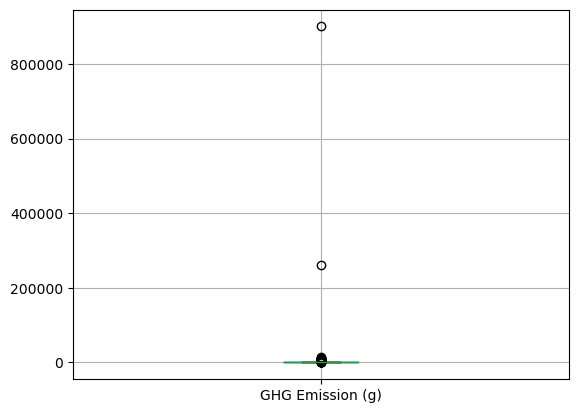

In [69]:
Products.boxplot(column=['GHG Emission (g)'], return_type='axes')

In [70]:
Products.boxplot(column=['N lost (g)'], return_type='axes')

<Axes: >

In [71]:
Products.boxplot(column=['Freshwater Withdrawals (L)'], return_type='axes')

<Axes: >

In [72]:
Products.boxplot(column=['Stress-Weighted Water Use (L)'], return_type='axes')

<Axes: >

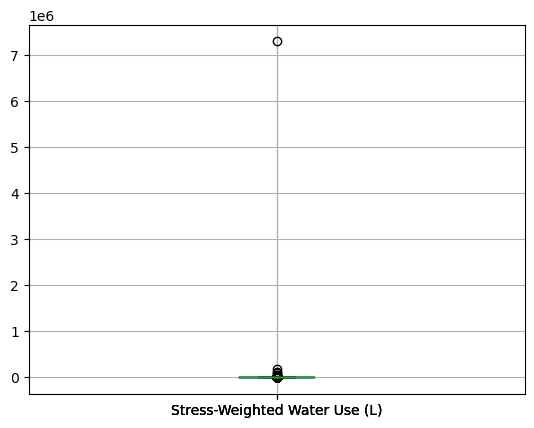

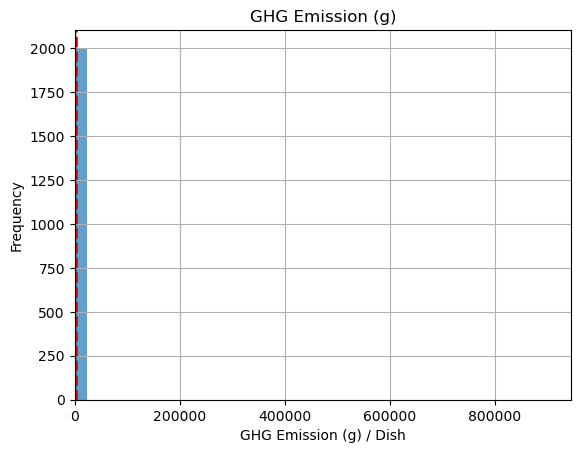

In [73]:
# These figures were not loading earlier because there were not any folders for the path required, so now that is working
Products.hist(column=['GHG Emission (g)'], bins= 40, alpha = 0.7)
plt.axvline(Products['GHG Emission (g)'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
plt.axvline(Products['GHG Emission (g)'].median(), color='k', linewidth=1, label = 'median')
plt.xlabel('GHG Emission (g) / Dish')
plt.ylabel('Frequency')
plt.xlim(left=0)
plt.savefig(path + 'GHGe_dish.png')
plt.show()

In [74]:
# Products.hist(column=['GHG Emission (g) / 100g'], bins= 40, alpha = 0.7)
# plt.axvline(Products['GHG Emission (g) / 100g'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['GHG Emission (g) / 100g'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('GHG Emission (g) / 100g')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'GHGe_100g.png')
# plt.show()

# Using isna() or isnull() to find NaN values in 'GHG Emission (g) / 100g' column
rows_with_nan = Products[Products['GHG Emission (g) / 100g'].isna()]

# Display the rows containing NaN values
print(rows_with_nan)


       ProdId            Description             SalesGroup  Weight (g)  \
9     R-41753              ADD|Salad  OK - BURRITO KITCHEN          0.0   
217   R-32121     DES|Cake|Tiramisu.    OK - BAKERY/DESSERT         0.0   
1105  R-33479  SIDE|Froyo Topper|4oz             OK - SIDES         0.0   

      GHG Emission (g)  N lost (g)  Land Use (m^2)  \
9                  0.0         0.0             0.0   
217                0.0         0.0             0.0   
1105               0.0         0.0             0.0   

      Freshwater Withdrawals (L)  Stress-Weighted Water Use (L)  \
9                            0.0                            0.0   
217                          0.0                            0.0   
1105                         0.0                            0.0   

      GHG Emission (g) / 100g  N lost (g) / 100g  \
9                         NaN                NaN   
217                       NaN                NaN   
1105                      NaN                NaN   

    

In [75]:
# Products.hist(column=['N lost (g)'], bins= 40, alpha = 0.7)
# plt.axvline(Products['N lost (g)'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['N lost (g)'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('N lost (g) / Dish')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'N lost_dish.png')
# plt.show()

In [76]:
# Products.hist(column=['N lost (g) / 100g'], bins= 40, alpha = 0.7)
# plt.axvline(Products['N lost (g) / 100g'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['N lost (g) / 100g'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('N lost (g) / 100g')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'N lost_100g.png')
# plt.show()

In [77]:
# Products.hist(column=['Freshwater Withdrawals (L)'], bins= 40, alpha = 0.7)
# plt.axvline(Products['Freshwater Withdrawals (L)'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['Freshwater Withdrawals (L)'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('Freshwater Withdrawals (L) / Dish')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'Fresh water_dish.png')
# plt.show()

In [78]:
# Products.hist(column=['Freshwater Withdrawals (L) / 100g'], bins= 40, alpha = 0.7)
# plt.axvline(Products['Freshwater Withdrawals (L) / 100g'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['Freshwater Withdrawals (L) / 100g'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('Freshwater Withdrawals (L) / 100g')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'Fresh water_100g.png')
# plt.show()

In [79]:
# Products.hist(column=['Stress-Weighted Water Use (L)'], bins= 40, alpha = 0.7)
# plt.axvline(Products['Stress-Weighted Water Use (L)'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['Stress-Weighted Water Use (L)'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('Stress-Weighted Water Use (L) / Dish')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'Stress water_dish.png')
# plt.show()

In [80]:
# Products.hist(column=['Stress-Weighted Water Use (L) / 100g'], bins= 40, alpha = 0.7)
# plt.axvline(Products['Stress-Weighted Water Use (L) / 100g'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['Stress-Weighted Water Use (L) / 100g'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('Stress-Weighted Water Use (L) / 100g')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'Stress water_100g.png')
# plt.show()

In [81]:
# Products.hist(column=['Land Use (m^2)'], bins= 40, alpha = 0.7)
# plt.axvline(Products['Land Use (m^2)'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['Land Use (m^2)'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('Land Use (m^2) / Dish')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'Land_Use_(m^2).png')
# plt.show()

In [82]:
# Products.hist(column=['Land Use (m^2) / 100g'], bins= 40, alpha = 0.7)
# plt.axvline(Products['Land Use (m^2) / 100g'].mean(), color='r', linestyle='dashed', linewidth=2, label = 'mean' )
# plt.axvline(Products['Land Use (m^2) / 100g'].median(), color='k', linewidth=1, label = 'median')
# plt.xlabel('Land Use (m^2) / 100g')
# plt.ylabel('Frequency')
# plt.xlim(left=0)
# plt.savefig(path + 'Land_Use_(m^2)_per_100g.png')
# plt.show()

In [83]:
Products.to_csv('C:/Users/ENTER_HERE/CFFS-S23/CFFS-22-23/data/preprocessed/Products_List.csv', index = False)
